In [223]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from PIL import ImageOps
from PIL.ImageFilter import GaussianBlur
from PIL.ImageFilter import MedianFilter
from PIL.ImageFilter import UnsharpMask

import pandas as pd 
import os, sys

import seaborn as sns

from sklearn.utils import shuffle

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
from os import listdir, makedirs
from os.path import join, exists, expanduser

from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import label_binarize

from keras.layers.core import Dropout, Activation

%matplotlib inline
import cv2

from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

from sklearn.neighbors import KNeighborsClassifier

from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier

from sklearn.ensemble import RandomForestClassifier
from keras.layers import Input, Dense
from keras.models import Sequential

from scipy import ndimage, misc

from joblib import dump



# Analyse classique 

Ce notebook à pour objectif de classifier les images en fonction des races de chiens que l'on peut y découvrir. 
L'approche de classification est classique. C'est à dire que l'on va venir détecter "mathématiquement" des points clefs et que l'on va venir ensuite regrouper les points clefs "similaires" dans un espace de grande dimension (typiquement 128) de sorte à obtenir des visual words. On effectue ensuite un apprentissage supervisé entre l'histogramme des visual words et les labels des images. On se base ici sur le travail effectué dans le notebook évaluation dont l'objectif était de déterminer les meillleurs hyperparamètres, ainsi que sur le travail effectué dans le notebook models dont l'objectif et de tester différents modèles de classification (travaux effectué sur un nombre de races restreint mais dont on conjecture la validité).

In [37]:
def plot_value_counts(col_name,df):       
    
    values_count = pd.DataFrame(df[col_name].dropna().value_counts())
    #print (values_count.shape)
    values_count.columns = ['count']
    # convert the index column into a regular column.
    values_count[col_name] = [ str(i) for i in values_count.index ]
    # add a column with the percentage of each data point to the sum of all data points.
    values_count['percent'] = values_count['count'].div(values_count['count'].sum()).multiply(100).round(2)
    # change the order of the columns.
    values_count = values_count.reindex([col_name,'count','percent'],axis=1)
    values_count.reset_index(drop=True,inplace=True)
    return (values_count)

In [33]:
# compter et ouvrir les fichiers 

# Open a file
path = "./Images"
dirs = os.listdir( path )

liste_name = []
liste_number = [] 

# This would print all the files and directories
for file in dirs:
    
    liste_name.append(str(file))
    path2 = "./Images/" + str(file)
    dirs2 = os.listdir( path2 )
    
    n = 0
    for pictures in dirs2:
        n = n + 1 
    liste_number.append(n)

No handles with labels found to put in legend.
C:\Users\tanne\Anaconda3\lib\site-packages\matplotlib\legend.py:641: UserWarning: Unrecognized location "accuracies". Falling back on "best"; valid locations are
	best
	upper right
	upper left
	lower left
	lower right
	right
	center left
	center right
	lower center
	upper center
	center

  % (loc, '\n\t'.join(self.codes)))


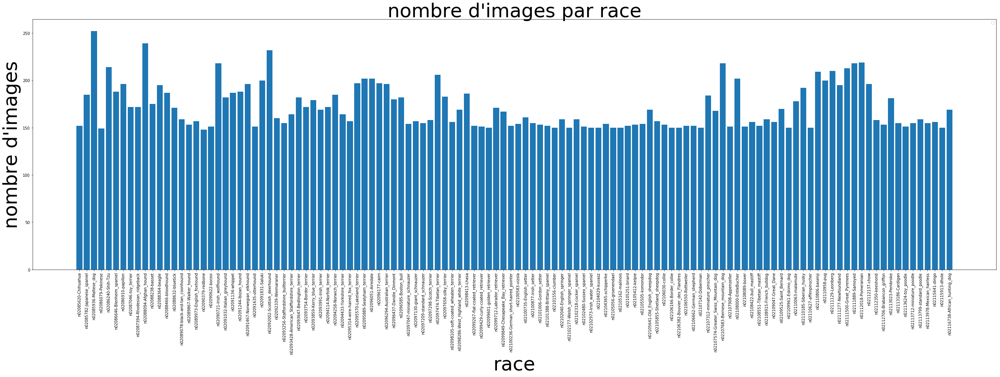

In [7]:
# afficher le nombre d'images par race

plt.figure(figsize=(45,12))
plt.title("nombre d'images par race",fontsize=50)
plt.bar(liste_name[:],liste_number[:])
plt.legend(loc = 'accuracies')
        
plt.axis('tight')
plt.ylabel("nombre d'images",fontsize=50)
plt.xlabel('race',fontsize=50)

plt.xticks(rotation=90)
plt.savefig('im.png', dpi=400)
plt.show()  

In [14]:
# ouvrir les fichiers 

# Open a file
path = "./Images"
dirs = os.listdir( path )

# list picture name 
picture = []
# list breed 
breed = []

# This would print all the files and directories
j = 0

i = 0

for file in (dirs):
    
    if (i > 119):
            
            break  # otherwise the generator would loop indefinitely
    
                
    i = i + 1
    
    
    path2 = "./Images/" + str(file)
    dirs2 = os.listdir( path2 )
    
       
    # compter les itérations
    i_t = 0  
    
        
    for file2 in dirs2:       
               
              
        train_n = int(np.around( 0.60 * len(dirs2)/2))
        valid_n = int(np.around(0.80 * len(dirs2)/2))        
        
        breed.append(str(file))
        picture.append(str(file2))
        
        
        i_t = i_t + 1
        
        file_picture = path2 + '/' + str(file2)        
        
        
        if (i_t <= train_n):            
                    
            img = load_img(file_picture)  # this is a PIL image  
            
            img.save("./images_t/tr/"  + str(file2) ) 
                    
        if (i_t > train_n) and (i_t <= valid_n):
            
            img = load_img(file_picture)  # this is a PIL image
            
            img.save("./images_t/te/"  + str(file2) ) 
            
        if (i_t > valid_n):
            
            img = load_img(file_picture)  # this is a PIL image
            
            img.save("./images_t/valid/"  + str(file2) )
            
        if i_t > (np.around(len(dirs2)/2)):
            
                break  # otherwise the generator would loop indefinitely
                

                
d = {'picture_name': picture[:], 'breed': breed[:]}
labels = pd.DataFrame(data=d)

labels.to_csv('labels.csv')

In [34]:
# Open a file
path = "./images_t/tr/"
dirs = os.listdir( path )

nb_train = len(dirs)

# Open a file
path = "./images_t/te/"
dirs = os.listdir( path )

nb_test = len(dirs)

# Open a file
path = "./images_t/valid/"
dirs = os.listdir( path )

nb_valid = len(dirs)
    
print (nb_train, nb_test, nb_valid)

1150 386 383


In [38]:
valeurs = plot_value_counts('breed',df=labels)

liste_name = valeurs.iloc[:,0]

In [35]:
print (liste_name.shape)

(120,)


In [163]:
# PARAMS 

# nombre de classes (races de chiens)
nb_classes = 120  #liste_name.shape[0]   #120
dim_Xception = 299
dim_vgg19 = 224


# ouvrir le fichier 

labels = pd.read_csv('labels.csv')

In [165]:
X_train = np.zeros((nb_train,dim_vgg19,dim_vgg19,3),dtype=np.float32)

y_train = np.zeros((nb_train,nb_classes),dtype='uint32')

In [36]:
X_test = np.zeros((nb_test,dim_vgg19,dim_vgg19,3),dtype=np.float32)

y_test = np.zeros((nb_test,nb_classes),dtype='uint32')

In [9]:
X_valid = np.zeros((nb_valid,dim_vgg19,dim_vgg19,3),dtype=np.float32)

y_valid = np.zeros((nb_valid,nb_classes),dtype='uint32')

In [10]:
j_valid = 0

# Open a file
path = "./images_t/valid/"
dirs = os.listdir( path )

for file in (dirs):
    #index = file.find('g')     
        
    class_name = labels[labels['picture_name'] == str(file)].iloc[0,2]
    y_valid[j_valid,:] = label_binarize([class_name], classes=liste_name)
    #print (y_valid[j_valid,:])
        
    file_picture = "./images_t/valid/" + str(file)
        
    img = load_img(file_picture, target_size=(224, 224))  # this is a PIL image 
    X_valid[j_valid,:,:,:] = img_to_array(img)
        
    j_valid = j_valid + 1

In [167]:
j_train = 0

# Open a file
path = "./images_t/tr/"
dirs = os.listdir( path )

for file in (dirs):
    #index = file.find('g') 
    
        
    class_name = labels[labels['picture_name'] == str(file)].iloc[0,2]
    y_train[j_train,:] = label_binarize([class_name], classes=liste_name)
    #print (y_train[j_train,:])
        
    file_picture =  "./images_t/tr/" + str(file)
        
    img = load_img(file_picture, target_size=(224, 224))  # this is a PIL image 
    X_train[j_train,:,:,:] = img_to_array(img)
        
    j_train = j_train + 1

In [37]:
j_te = 0

# Open a file
path = "./images_t/te/"
dirs = os.listdir( path )

for file in (dirs):
    #index = file.find('g')    
    
    class_name = labels[labels['picture_name'] == str(file)].iloc[0,2]
    y_test[j_te,:] = label_binarize([class_name], classes=liste_name)
    #print (y_train[j_train,:])
        
    file_picture =  "./images_t/te/" + str(file)
        
    img = load_img(file_picture, target_size=(224, 224))  # this is a PIL image 
    X_test[j_te,:,:,:] = img_to_array(img)
        
    j_te = j_te + 1

In [160]:
def visualiser (X_train,nb_exemples,mixed):
    
    if (mixed == 1):    
        # mixed data do not print every time the same pictures    
        X_train = shuffle(X_train)
        
    # i breack
    i_b = 0    

    fig = plt.figure(1, figsize=(16, 16))

    grid = ImageGrid(fig, 111, nrows_ncols=(int(nb_exemples/4), int(nb_exemples/4)), axes_pad=0.1)
        
    for i in range (nb_exemples):       
        
        ax = grid[i_b]        
        
        ax.imshow(X_train[i,:,:,:] / 255.)        

        ax.axis('off')
                
        i_b = i_b + 1         



In [15]:
def visualiser_hist(X_train,nb_exemples,mixed):

    if (mixed == 1):    
       # mixed data do not print every time the same pictures    
       X_train = shuffle(X_train)
        
    # i breack
    i_b = 0    
    
    #plt.figure(1, figsize=(16, 16))

    fig, axs = plt.subplots(1, 1, figsize=(16, 7))
    
    plt.title("histogramme des exemples")
          
    for i in range (nb_exemples):       
        
               
        plt.hist(X_train[i,:,:,:].flatten(), bins=range(256), label='image n°{}'.format(i)) 
        
        plt.legend()
        
        axs.set_ylim(0, 3600)    
                        
        i_b = i_b + 1         

  

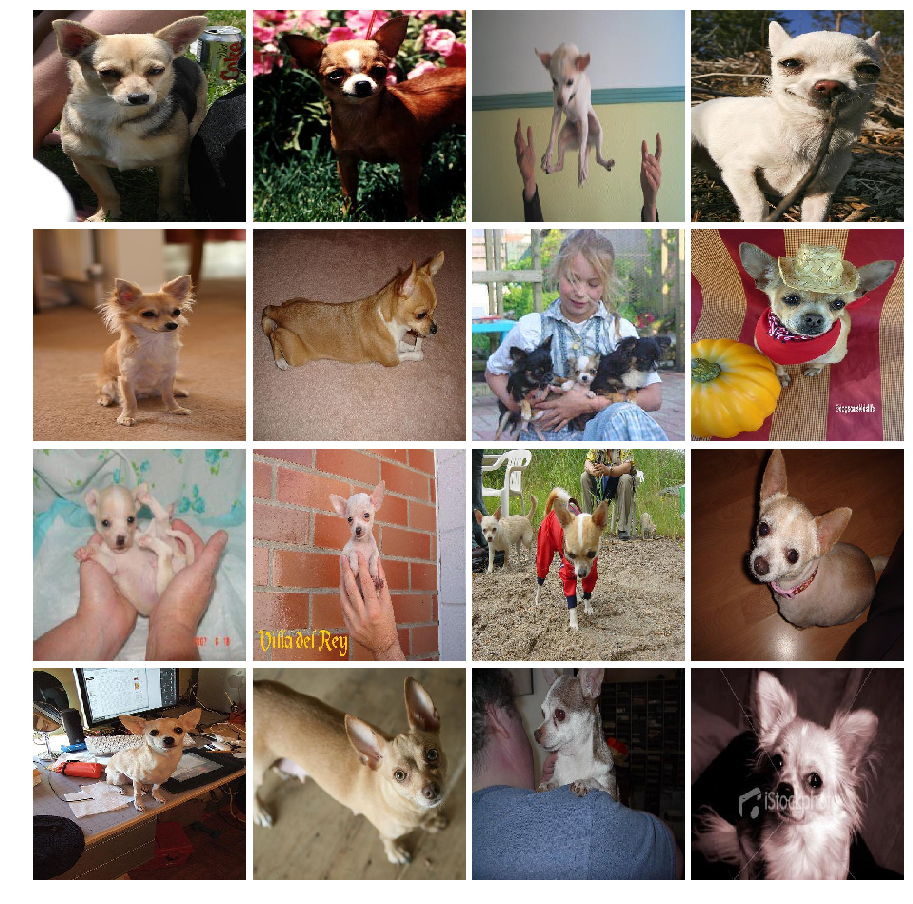

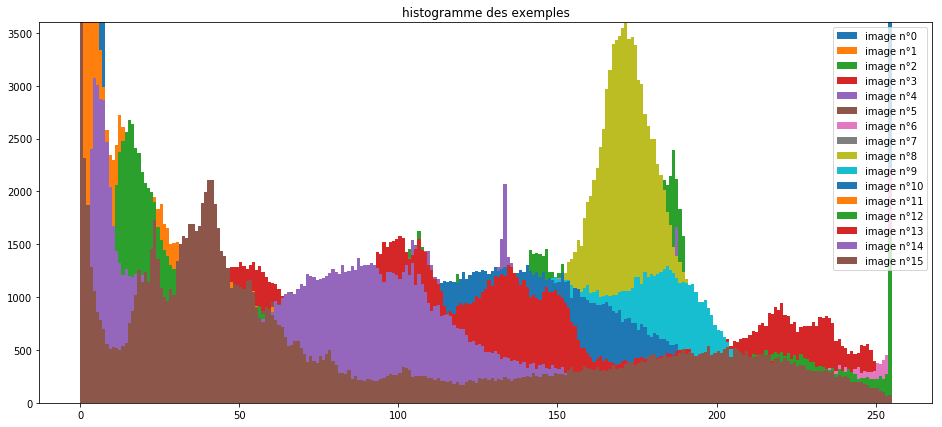

In [41]:
# mixed = 1 pour générer aléatoirement
visualiser(X_train=X_train,nb_exemples=16,mixed=0)

# mixed = 1 pour générer aléatoirement
visualiser_hist(X_train=X_train,nb_exemples=16,mixed=0)



In [42]:
for i in range (X_train.shape[0]):
    
    img = array_to_img(X_train[i,:,:,:])
    img2 = ImageOps.autocontrast(img, cutoff=0, ignore=None)
    img3 = img_to_array(img2)
    
    X_train[i,:,:,:] = img3[:,:,:]
    
   

In [43]:
for i in range (X_valid.shape[0]):
    
    img = array_to_img(X_valid[i,:,:,:])
    img2 = ImageOps.autocontrast(img, cutoff=0, ignore=None)
    img3 = img_to_array(img2)
    
    X_valid[i,:,:,:] = img3[:,:,:]

In [44]:
for i in range (X_test.shape[0]):
    
    img = array_to_img(X_test[i,:,:,:])
    img2 = ImageOps.autocontrast(img, cutoff=0, ignore=None)
    img3 = img_to_array(img2)
    
    X_test[i,:,:,:] = img3[:,:,:]

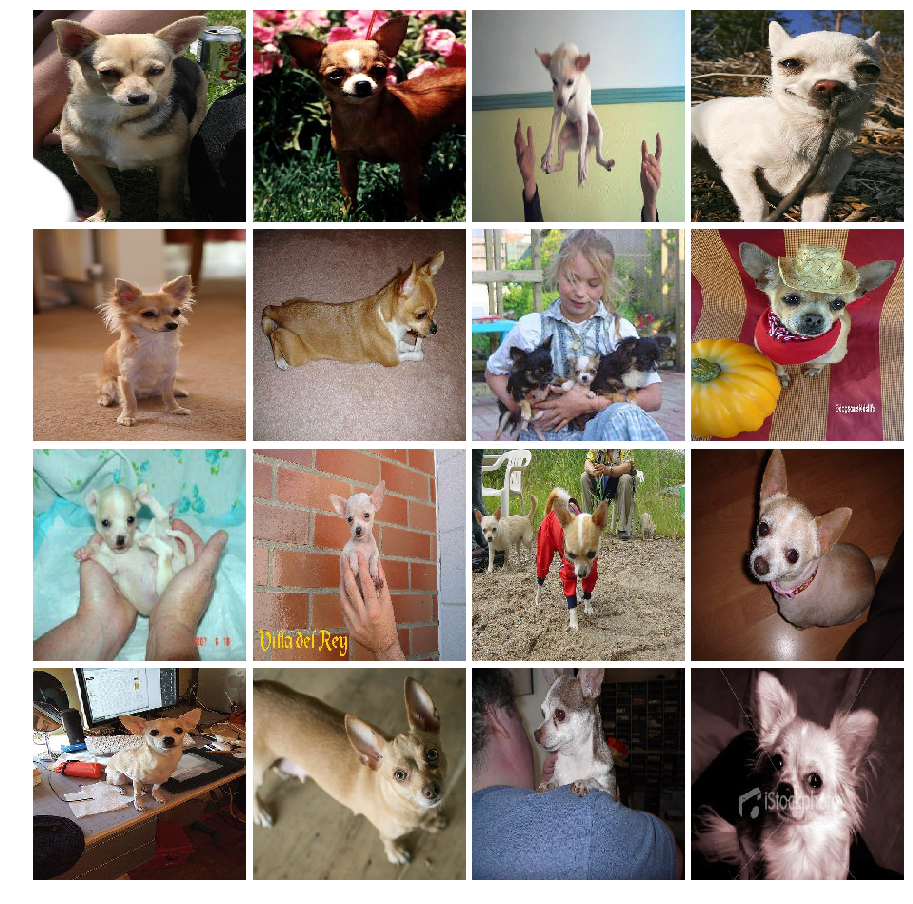

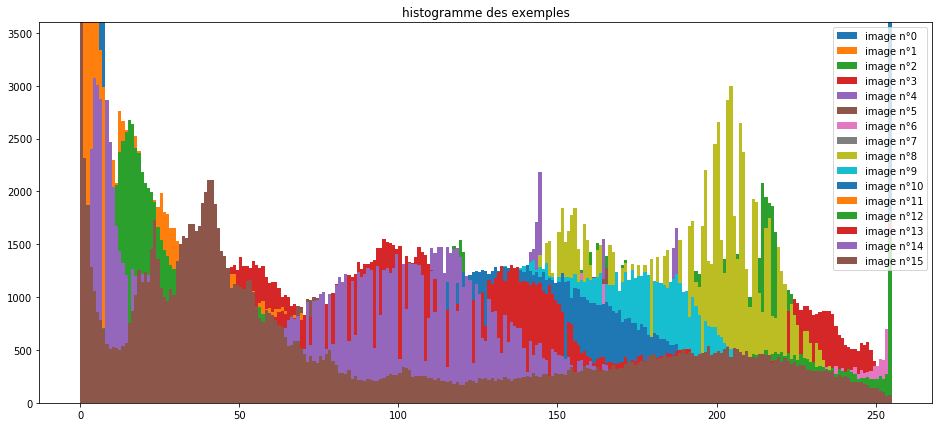

In [45]:
# mixed = 1 pour générer aléatoirement
visualiser(X_train=X_train,nb_exemples=16,mixed=0)

# mixed = 1 pour générer aléatoirement
visualiser_hist(X_train=X_train,nb_exemples=16,mixed=0)


In [46]:
for i in range (X_train.shape[0]):
    
    img = array_to_img(X_train[i,:,:,:])
    img2 = ImageOps.equalize(img)
    img3 = img_to_array(img2)
    
    X_train[i,:,:,:] = img3[:,:,:]

In [47]:
for i in range (X_valid.shape[0]):
    
    img = array_to_img(X_valid[i,:,:,:])
    img2 = ImageOps.equalize(img)
    img3 = img_to_array(img2)
    
    X_valid[i,:,:,:] = img3[:,:,:]

In [48]:
for i in range (X_test.shape[0]):
    
    img = array_to_img(X_test[i,:,:,:])
    img2 = ImageOps.equalize(img)
    img3 = img_to_array(img2)
    
    X_test[i,:,:,:] = img3[:,:,:]

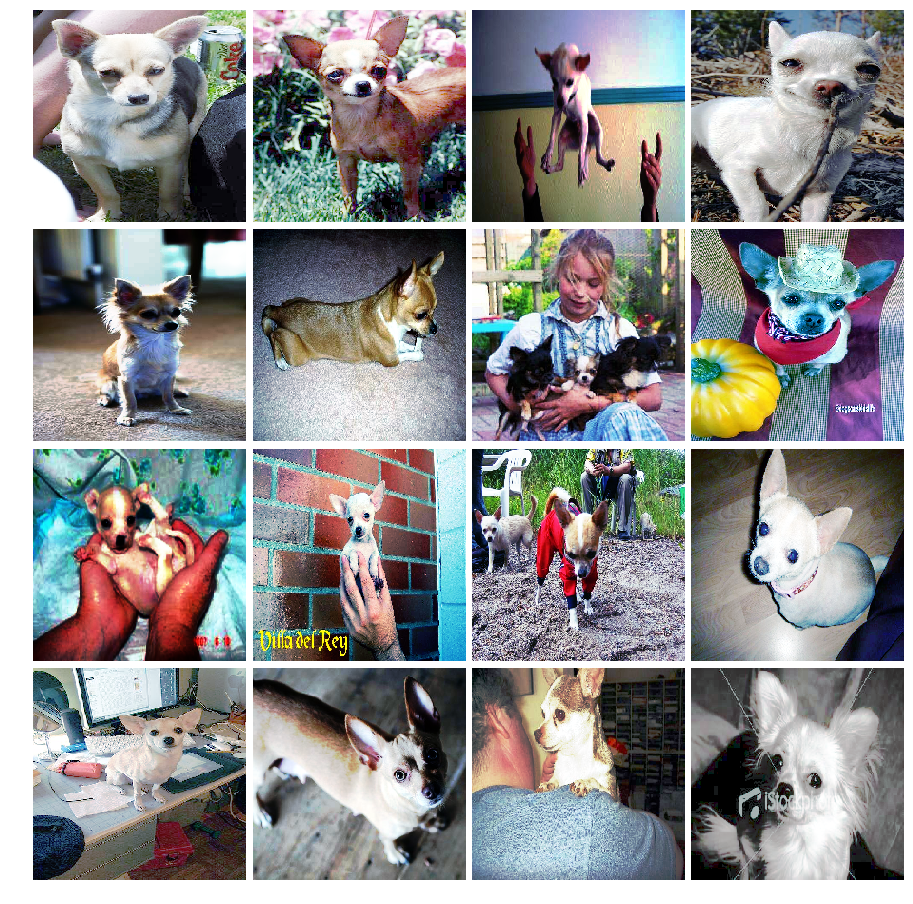

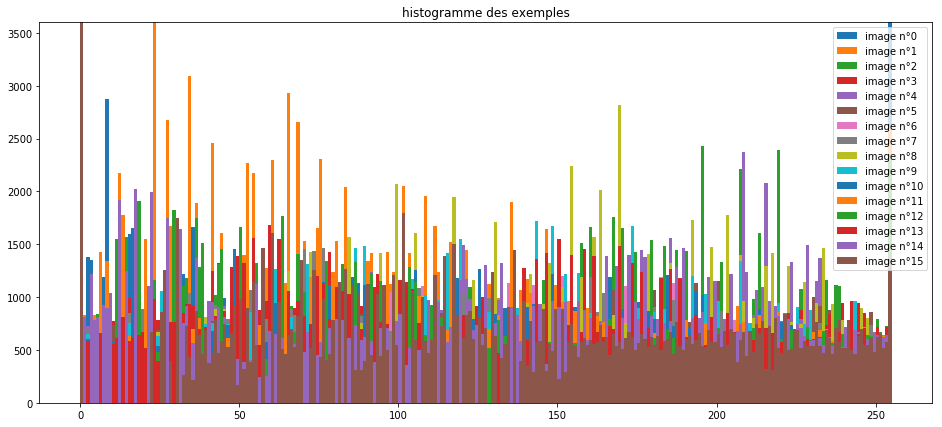

In [49]:
# mixed = 1 pour générer aléatoirement
visualiser(X_train=X_train,nb_exemples=16,mixed=0)

# mixed = 1 pour générer aléatoirement
visualiser_hist(X_train=X_train,nb_exemples=16,mixed=0)


In [50]:
for i in range (X_train.shape[0]):
    
    img = array_to_img(X_train[i,:,:,:])
    img2 = img.filter(GaussianBlur(radius=2))
    img3 = img_to_array(img2)
    
    X_train[i,:,:,:] = img3[:,:,:]

In [51]:
for i in range (X_valid.shape[0]):
    
    img = array_to_img(X_valid[i,:,:,:])
    img2 = img.filter(GaussianBlur(radius=2))
    img3 = img_to_array(img2)
    
    X_valid[i,:,:,:] = img3[:,:,:]

In [52]:
for i in range (X_test.shape[0]):
    
    img = array_to_img(X_test[i,:,:,:])
    img2 = img.filter(GaussianBlur(radius=2))
    img3 = img_to_array(img2)
    
    X_test[i,:,:,:] = img3[:,:,:]

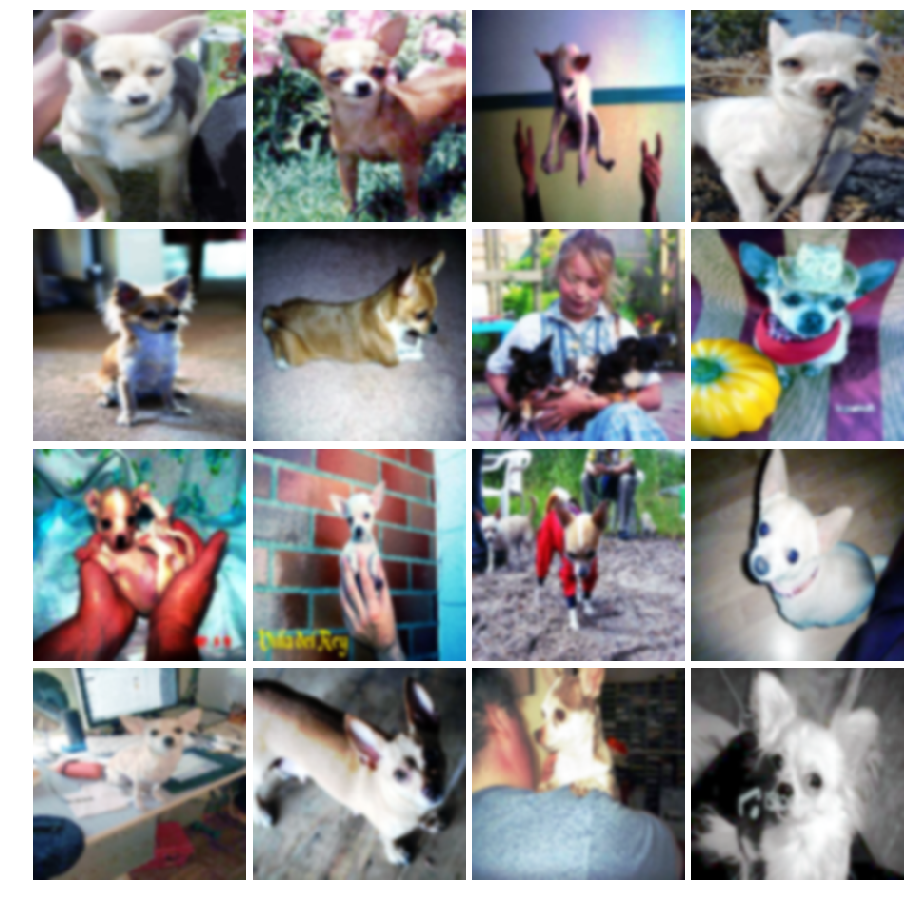

In [53]:
# mixed = 1 pour générer aléatoirement
visualiser(X_train=X_train,nb_exemples=16,mixed=0)

In [18]:
def ZCA_whitening(X_train,eps):
    """effectue un whitening via une ZCA objectif similaire au PCA whitening (hyperparamètre eps)"""
    
    # whitening pictures  

    X = X_train.reshape(X_train.shape[0], X_train.shape[1]*X_train.shape[2]*X_train.shape[3])
    # se ramenner à l'interval [0,1]
    X = 1./255 * X

    # enlever la moyenne pixel par pixel 
    X_norm = X - np.mean(X,axis=0)

    cov = np.cov(X_norm, rowvar=True)

    U,S,V = np.linalg.svd(cov)

    # epsilon est le coef de la ZCA     
    epsilon = eps

    # on résoud l'équation matricielle 
    X_ZCA = U.dot(np.diag(1.0/np.sqrt(S + epsilon))).dot(U.T).dot(X_norm)

    X_ZCA_rescaled = (X_ZCA - X_ZCA.min()) / (X_ZCA.max() - X_ZCA.min())

    X_train = X_ZCA_rescaled.reshape(X_train.shape[0], X_train.shape[1], X_train.shape[2], X_train.shape[3])

    X_train = X_train*255

    return (X_train)



In [21]:
X_train = ZCA_whitening(X_train,eps=0.001)

In [22]:
X_valid = ZCA_whitening(X_valid,eps=0.001)

In [23]:
X_test = ZCA_whitening(X_test,eps=0.001)

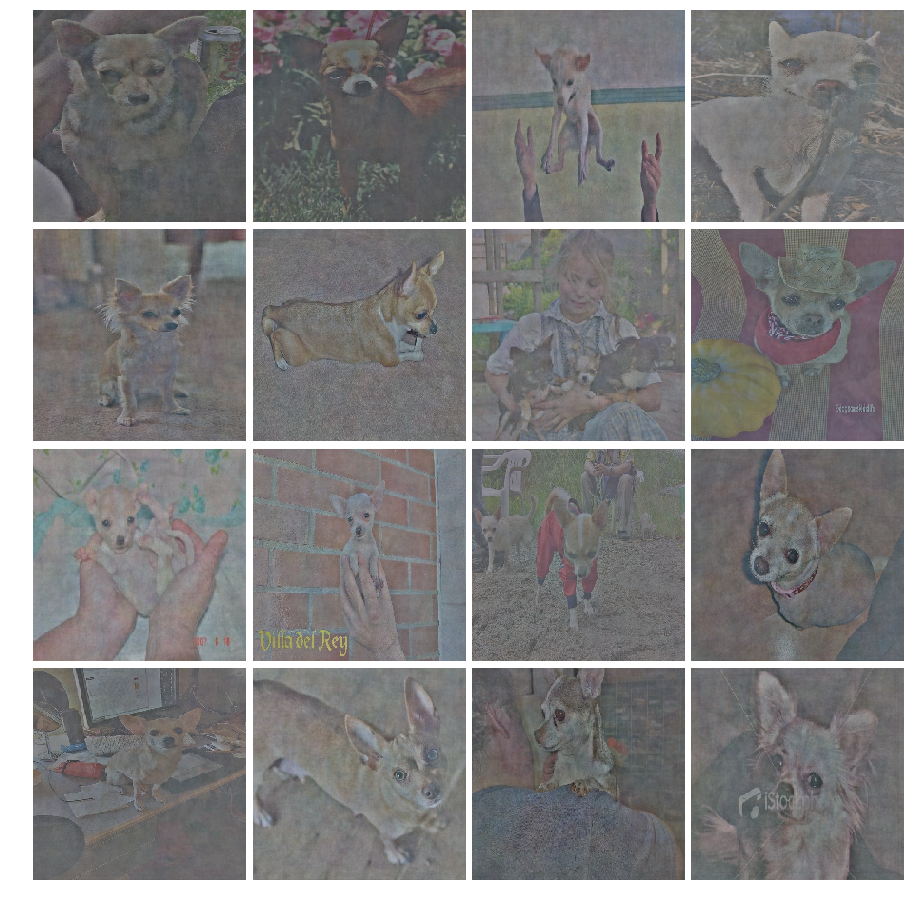

In [69]:
# mixed = 1 pour générer aléatoirement
visualiser(X_train=X_train,nb_exemples=16,mixed=0)

In [38]:
# init params sharping
r = 4
p = 170
t = 4

In [13]:
for i in range (X_train.shape[0]):
    
    img = array_to_img(X_train[i,:,:,:])
    img2 = img.filter(UnsharpMask(radius=r, percent=p, threshold=t))
    img3 = img_to_array(img2)
    
    X_train[i,:,:,:] = img3[:,:,:]

In [14]:
for i in range (X_valid.shape[0]):
    
    img = array_to_img(X_valid[i,:,:,:])
    img2 = img.filter(UnsharpMask(radius=r, percent=p, threshold=t))
    img3 = img_to_array(img2)
    
    X_valid[i,:,:,:] = img3[:,:,:]

In [39]:
for i in range (X_test.shape[0]):
    
    img = array_to_img(X_test[i,:,:,:])
    img2 = img.filter(UnsharpMask(radius=r, percent=p, threshold=t))
    img3 = img_to_array(img2)
    
    X_test[i,:,:,:] = img3[:,:,:]

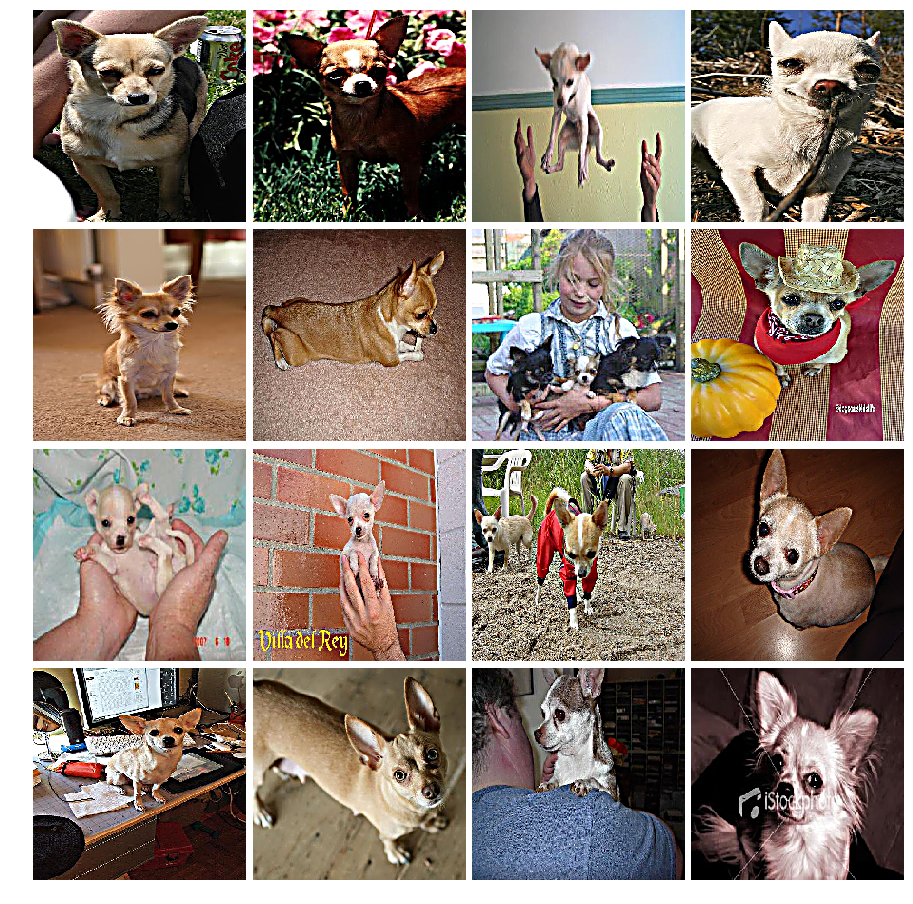

In [215]:
# mixed = 1 pour générer aléatoirement p = 150
visualiser(X_train=X_train,nb_exemples=16,mixed=0)

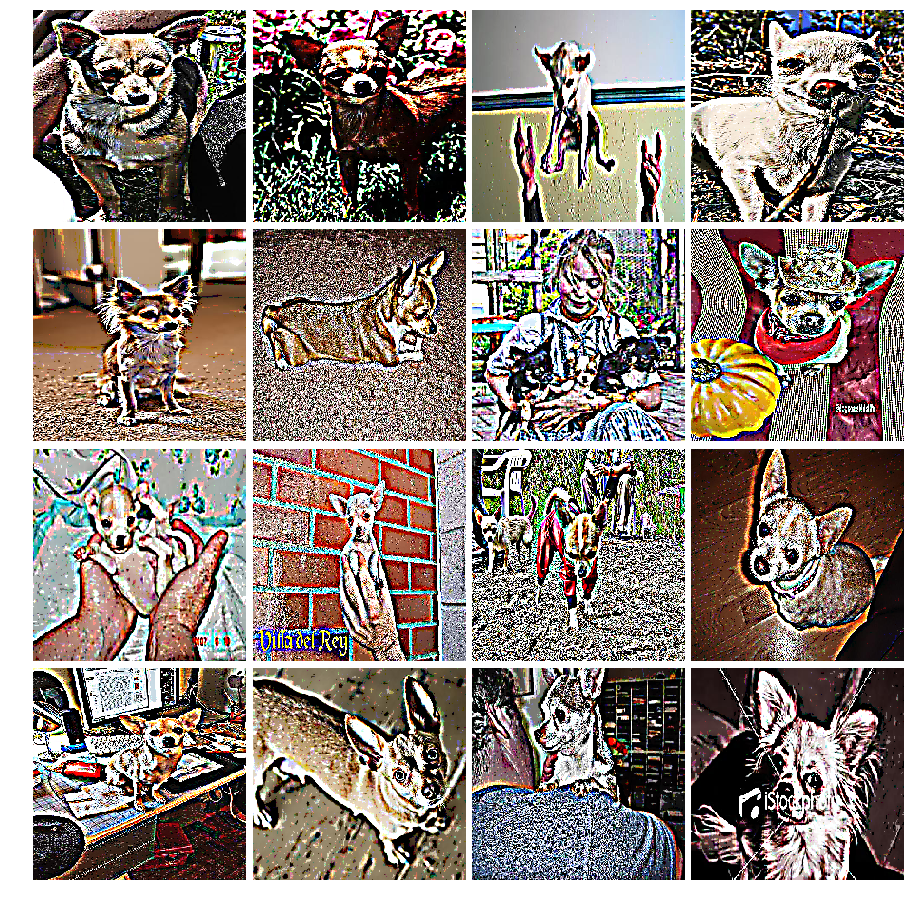

In [226]:
# mixed = 1 pour générer aléatoirement p = 1500
visualiser(X_train=X_train,nb_exemples=16,mixed=0)

In [227]:
# rayon median 
median = 3

for i in range (X_train.shape[0]):
    
    img = array_to_img(X_train[i,:,:,:])
    img2 = img.filter(MedianFilter(size=median))
    img3 = img_to_array(img2)
    
    X_train[i,:,:,:] = img3[:,:,:]

In [228]:
for i in range (X_valid.shape[0]):
    
    img = array_to_img(X_valid[i,:,:,:])
    img2 = img.filter(MedianFilter(size=median))
    img3 = img_to_array(img2)
    
    X_valid[i,:,:,:] = img3[:,:,:]

In [ ]:
for i in range (X_test.shape[0]):
    
    img = array_to_img(X_test[i,:,:,:])
    img2 = img.filter(MedianFilter(size=median))
    img3 = img_to_array(img2)
    
    X_test[i,:,:,:] = img3[:,:,:]

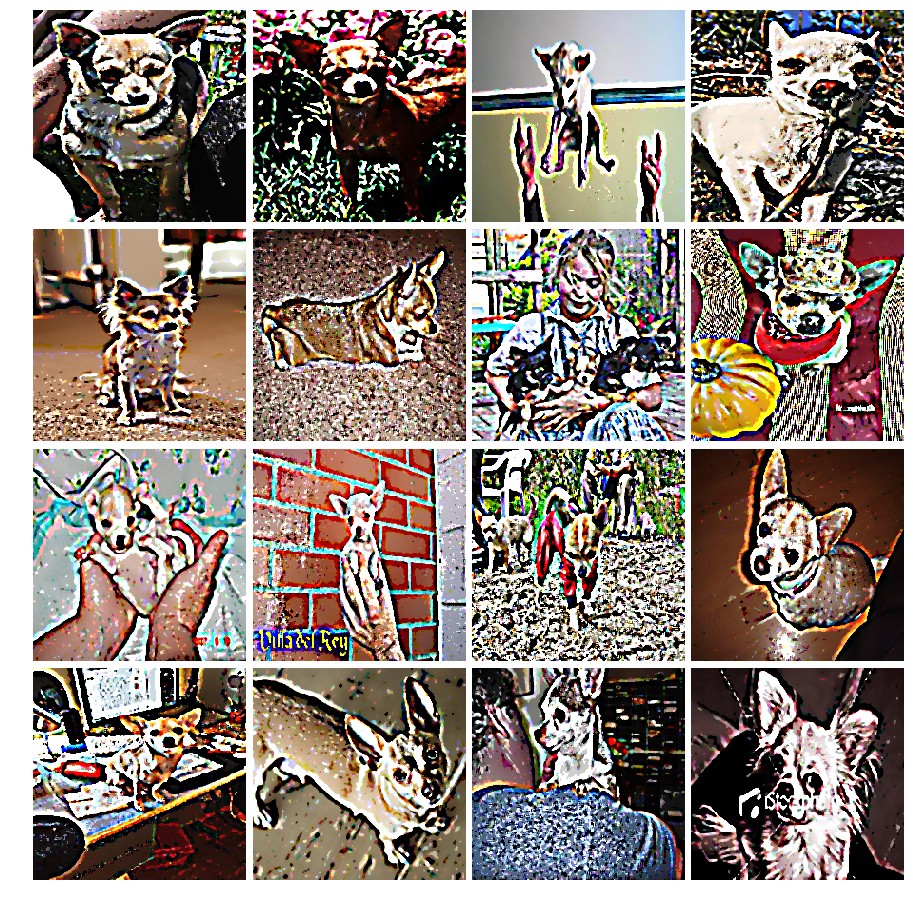

In [230]:
# mixed = 1 pour générer aléatoirement 
visualiser(X_train=X_train,nb_exemples=16,mixed=0)

In [40]:
# application de l'algorithme SIFT (librairie CV2)

def to_gray(color_img):
    gray = cv2.cvtColor(color_img, cv2.COLOR_BGR2GRAY)
    return gray

def gen_sift_features(gray_img):
    
    #sift = cv2.xfeatures2d.SIFT_create()
    sift = cv2.xfeatures2d.SIFT_create(nfeatures=0,nOctaveLayers=2,contrastThreshold=0.115,
                                   edgeThreshold=10,sigma=2)
    # kp is the keypoints
    #
    # desc is the SIFT descriptors, they're 128-dimensional vectors
    # that we can use for our final features
    kp, desc = sift.detectAndCompute(gray_img, None)
    return kp, desc

def show_sift_features(gray_img, color_img, kp):
    return plt.imshow(cv2.drawKeypoints(gray_img, kp, color_img.copy()))

In [20]:
def visualiser2(X_train,nb_exemples,mixed):
    
    if (mixed == 1):    
        # mixed data do not print every time the same pictures    
        X_train = shuffle(X_train)
        
    # i breack
    i_b = 0  
    
    fig, axarr = plt.subplots(int(nb_exemples/4), int(nb_exemples/4), figsize=(16,16),sharex=True)
        
    j = 0   
    j2 = 0
    for i in range (nb_exemples):        
        
        if (j == int(nb_exemples/4)):
            
            j = 0 
            j2 = j2 + 1
        
               
        img_gray = to_gray(color_img=X_train[i,:,:,:].astype(np.uint8))
        
        
        kp, desc = gen_sift_features(img_gray)
       
        axarr[j,j2].imshow(cv2.drawKeypoints(img_gray, kp, X_train[i,:,:,:].astype(np.uint8).copy()))  
        
        axarr[j,j2].axis('off')  
        
                
        j = j + 1  
        
   



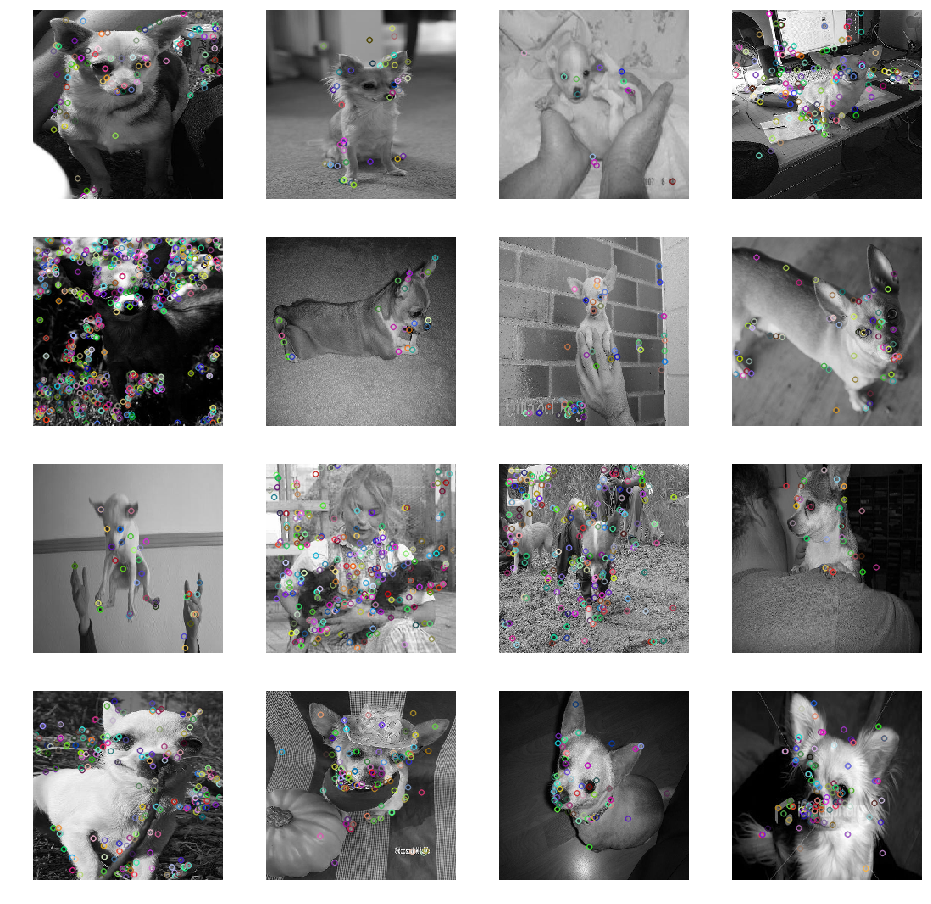

In [100]:
# visualisation sans filtre
visualiser2(X_train=X_train,nb_exemples=16,mixed=0)

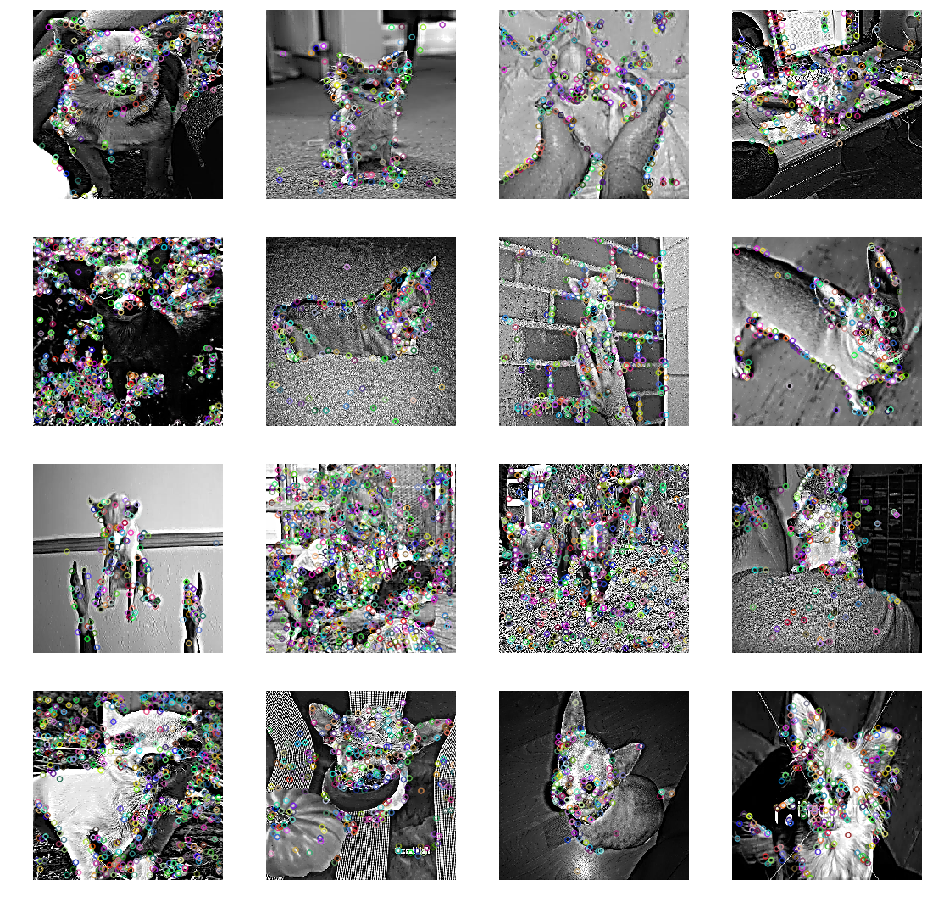

In [194]:
# visualisation avec sharpening
visualiser2(X_train=X_train,nb_exemples=16,mixed=0)

In [219]:
def app(X_train):
    # effectue un DOG pour la visualisation
    
    for i in range (50):
        
        img = array_to_img(X_train[i,:,:,:])
        img2 = img.filter(GaussianBlur(radius=0.5))
        img3 = img_to_array(img2)
        #print (img3)
        img_x = array_to_img(X_train[i,:,:,:])
        img4 = img_x.filter(GaussianBlur(radius=3))
        img5 = img_to_array(img4)
        #print (img5)
        img_f = (img5[:,:,:] - img3[:,:,:])*5
        X_train[i,:,:,:] = img_f[:,:,:]
        #print (img_f)
    
    return (X_train)
        
        

In [218]:
X_ess = X_train.copy()

In [220]:
X_ess = app(X_train=X_ess)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

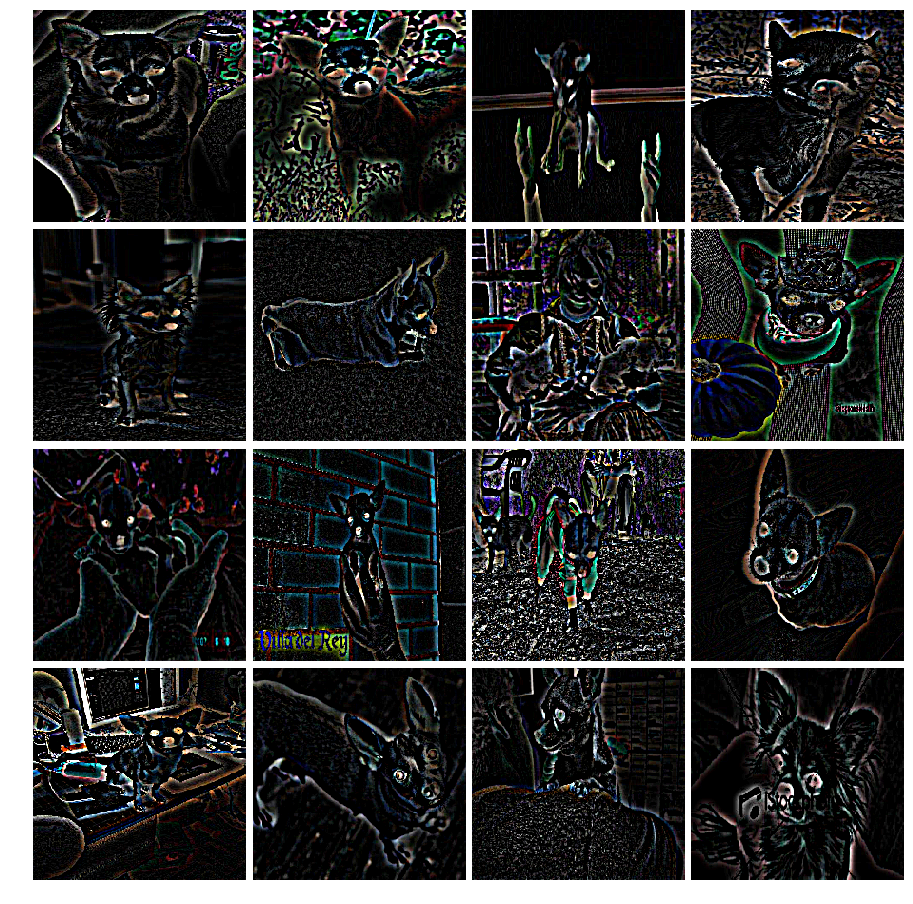

In [221]:
# mixed = 1 pour générer aléatoirement 
visualiser(X_train=X_ess,nb_exemples=16,mixed=0)

In [154]:
def visualiser3(X_train):
    
    for i in range (16):
        
        fig, axs = plt.subplots(4, 4, figsize=(5, 5))
        
        plt.subplots_adjust(left  = 0, right = 1, bottom = 0, top = 1,hspace=0, wspace = 0 )
    
        # converting to gray scale
        gray = to_gray(X_train[i,:,:,:].astype(np.uint8))

        # remove noise
        img = cv2.GaussianBlur(gray,(3,3),0)

        # convolute with proper kernels
        laplacian = cv2.Laplacian(img,cv2.CV_64F)
        sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)  # x
        sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)  # y

        plt.subplot(2,2,1),plt.imshow(img,cmap = 'gray')
        plt.axis('off')  
        #plt.title('Original'), plt.xticks([]), plt.yticks([])
        plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
        plt.axis('off')  
        #plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
        plt.subplot(2,2,3),plt.imshow(sobelx,cmap = 'gray')
        plt.axis('off')  
        #plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
        plt.subplot(2,2,4),plt.imshow(sobely,cmap = 'gray')
        plt.axis('off')  
        #plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])   
        
        plt.subplots_adjust(left  = 0, right = 1, bottom = 0, top = 1,hspace=0, wspace = 0 )
        
        

        plt.savefig('picture{}.jpg'.format(i)) 
        
def visualiser4(X_train): 
    fig, axs = plt.subplots(4, 4, figsize=(15, 20))
    
    plt.subplots_adjust(left  = 0, right = 1, bottom = 0, top = 1,hspace=0, wspace = 0)
    
            
    #plt.title('Original'), plt.xticks([]), plt.yticks([])
    img = load_img('picture0.jpg', target_size=(500, 500))
    plt.subplot(4,4,1),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Original'), plt.xticks([]), plt.yticks([])
    img = load_img('picture1.jpg', target_size=(50, 50))
    #img = Image.open('picture1.jpg')        
    plt.subplot(4,4,2),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
    img = load_img('picture2.jpg', target_size=(500, 500))
    #img = Image.open('picture2.jpg')
    plt.subplot(4,4,3),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
    img = load_img('picture3.jpg', target_size=(500, 500))
    #img = Image.open('picture3.jpg')
    plt.subplot(4,4,4),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])
    img = load_img('picture4.jpg', target_size=(500, 500))
    #img = Image.open('picture4.jpg')
    plt.subplot(4,4,5),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Original'), plt.xticks([]), plt.yticks([])
    img = load_img('picture5.jpg', target_size=(500, 500))
    #img = Image.open('picture5.jpg')
    plt.subplot(4,4,6),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
    img = load_img('picture6.jpg', target_size=(500, 500))
    #img = Image.open('picture6.jpg')
    plt.subplot(4,4,7),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
    img = load_img('picture7.jpg', target_size=(500, 500))
    #img = Image.open('picture7.jpg')
    plt.subplot(4,4,8),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
    
    #plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])
    img = load_img('picture8.jpg', target_size=(500, 500))
    #img = Image.open('picture8.jpg')
    plt.subplot(4,4,9),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Original'), plt.xticks([]), plt.yticks([])
    img = load_img('picture9.jpg', target_size=(500, 500))
    #img = Image.open('picture9.jpg')
    plt.subplot(4,4,10),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
    img = load_img('picture10.jpg', target_size=(500, 500))
    #img = Image.open('picture10.jpg')
    plt.subplot(4,4,11),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
    img = load_img('picture11.jpg', target_size=(500, 500))
    #img = Image.open('picture11.jpg')
    plt.subplot(4,4,12),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])
    img = load_img('picture12.jpg', target_size=(500, 500))
    #img = Image.open('picture12.jpg')
    plt.subplot(4,4,13),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Original'), plt.xticks([]), plt.yticks([])
    img = load_img('picture13.jpg', target_size=(500, 500))
    #img = Image.open('picture13.jpg')
    plt.subplot(4,4,14),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
    img = load_img('picture14.jpg', target_size=(500, 500))
    #img = Image.open('picture14.jpg')
    plt.subplot(4,4,15),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
        
    #plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
    img = load_img('picture15.jpg', target_size=(500, 500))
    #img = Image.open('picture15.jpg')
    plt.subplot(4,4,16),plt.imshow(img,cmap = 'gray')
    plt.axis('off')  
    
    
  

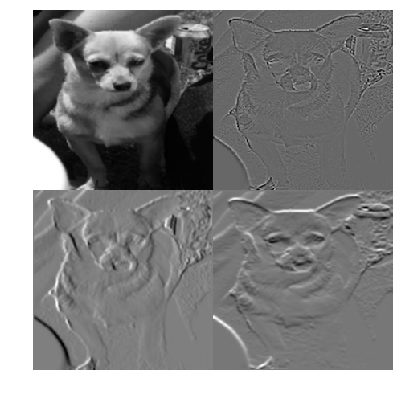

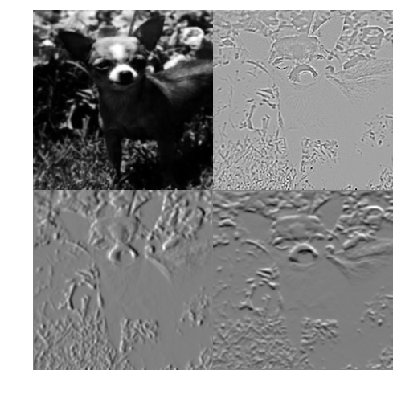

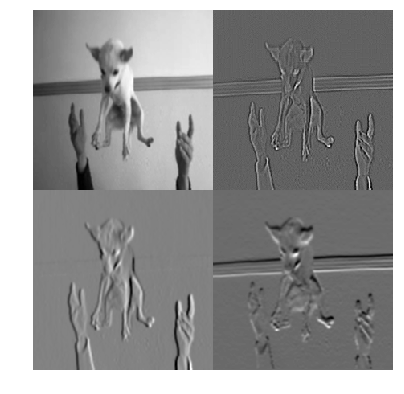

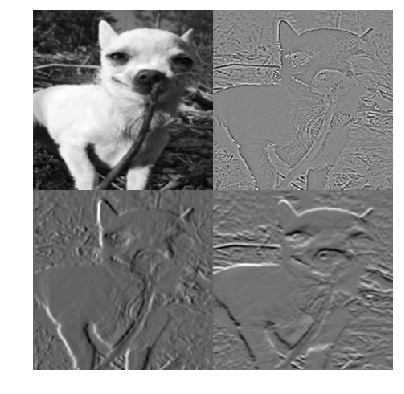

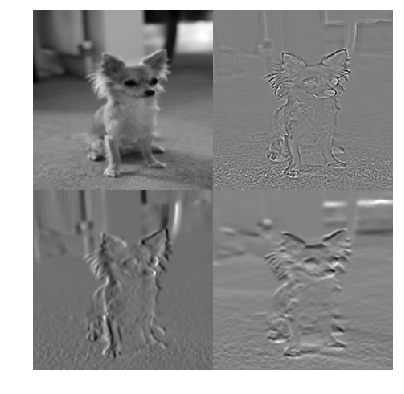

...

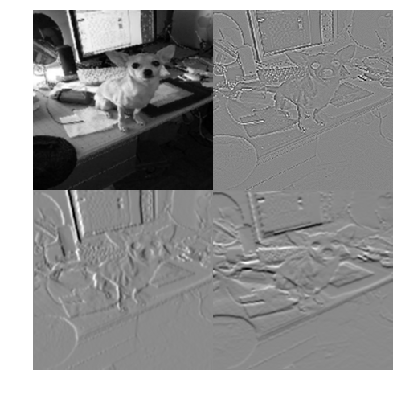

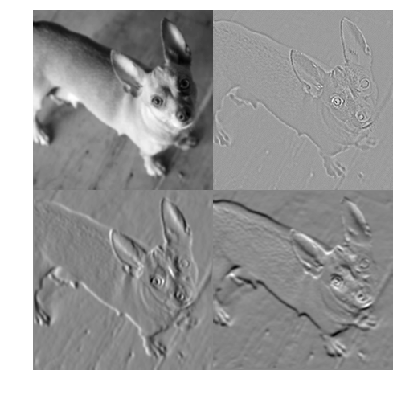

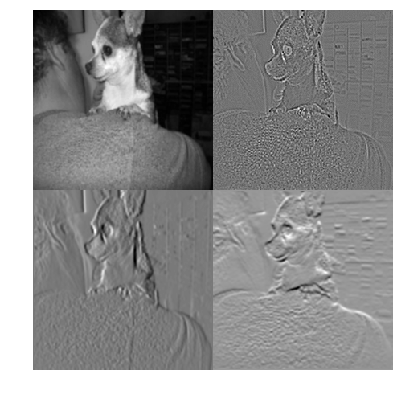

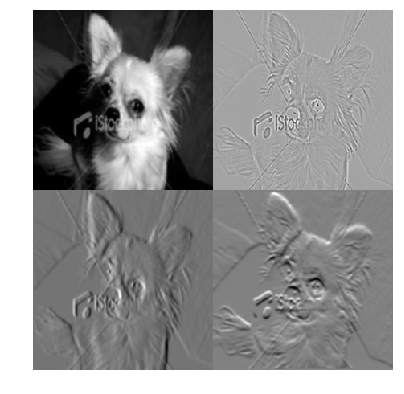

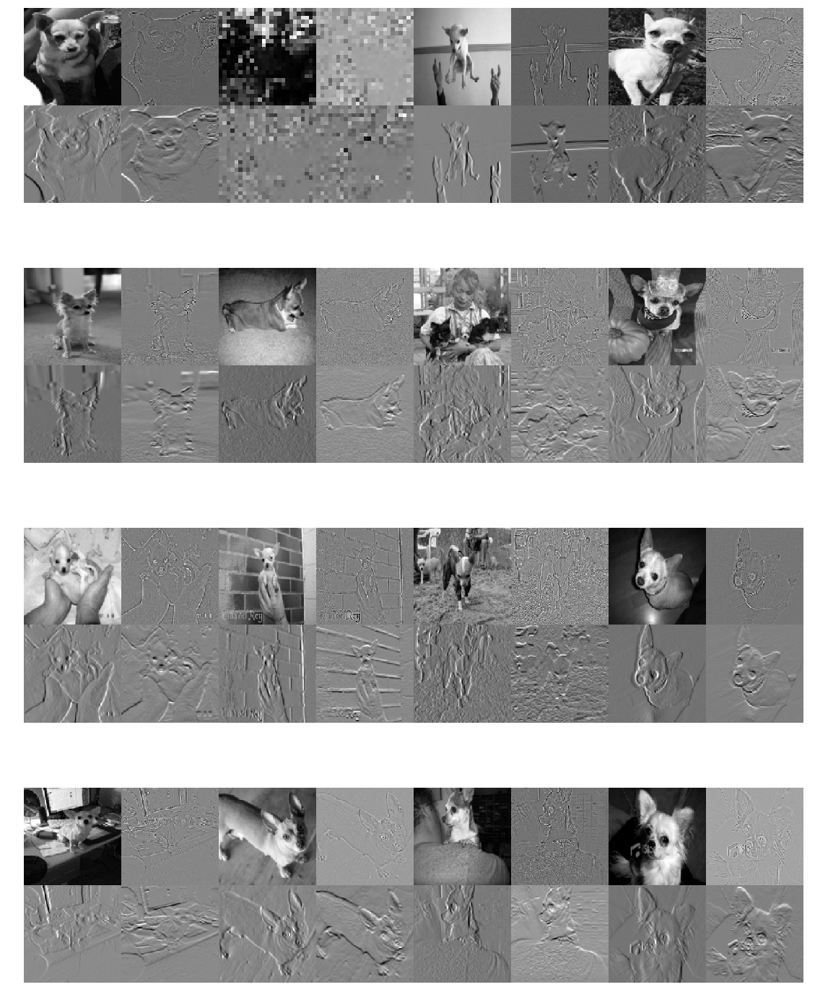

In [155]:
visualiser3(X_train=X_train)
visualiser4(X_train=X_train)

In [41]:
def special_points(X_train): 
    
    dim = 0
    for i in range (X_train.shape[0]):    

        # image grise (8 bits)               
        img_gray = to_gray(color_img=X_train[i,:,:,:].astype(np.uint8))

        # trouver les points spéciaux (SIFT) 
        kp, desc = gen_sift_features(img_gray)

        dim = dim + desc.shape[0]


    # liste des points spéciaux 
    special = np.zeros((dim,128))

    # vecteur d'indice 
    indice = np.zeros(dim)

    j = 0    
    for i in range (X_train.shape[0]):    

        # image grise (8 bits)               
        img_gray = to_gray(color_img=X_train[i,:,:,:].astype(np.uint8))

        # trouver les points spéciaux (SIFT) 
        kp, desc = gen_sift_features(img_gray)    

        for d in range (desc.shape[0]):
            # ajouter le point
            special[j,:] = desc[d]

            indice[j] = i

            j = j + 1   
            
    return (indice,special)        
        

In [17]:
indice, special = special_points(X_train=X_train)[:]

In [18]:
print (special.shape)

(1200312, 128)


In [42]:
indice_te, special_te = special_points(X_train=X_test)[:]

In [19]:
indice_valid, special_valid = special_points(X_train=X_valid)[:]

In [ ]:
# standardiser les données 
sdt = StandardScaler()
X_sdt = sdt.fit_transform(special)

# visualiser la structure avec TSNE (en 2d)

tsne = TSNE(n_components=2, perplexity=30, n_iter=1000,init='pca' )

X_tsne = tsne.fit_transform(shuffle(X_sdt)[0:2000,:])


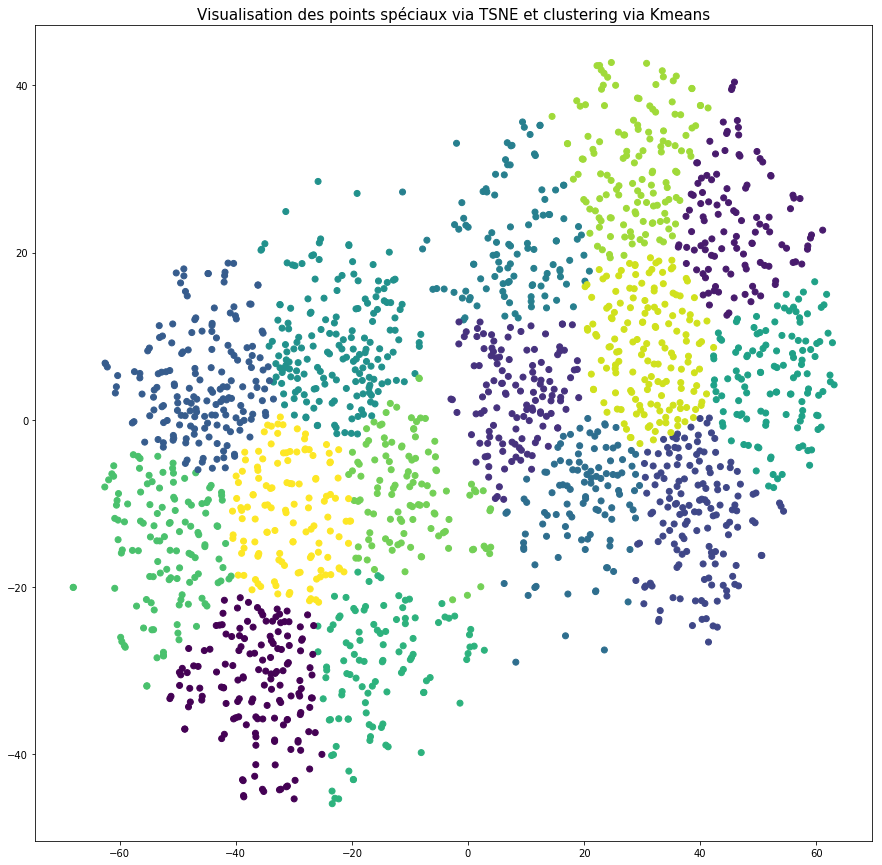

In [248]:
# visualisation
fig, ax = plt.subplots(figsize=(15, 15))

kmeans = KMeans(n_clusters=15, random_state=0).fit(X_tsne)
    
kmeans.transform(X_tsne)


plt.scatter(X_tsne[:,0], X_tsne[:,1],c=kmeans.labels_)


plt.title("Visualisation des points spéciaux via TSNE et clustering via Kmeans",fontsize=15)
plt.savefig('tsne1.png', dpi=400)


In [188]:

# réduire la dimmension (via ACP)
pca = PCA(n_components=118) 
pca.fit(X_sdt)

print ("pourcentage de variance expliqué")
print (pca.explained_variance_ratio_.sum())
X_projected = pca.transform(X_sdt)

X_projected = X_sdt

pourcentage de variance expliqué
0.995030435017809


In [20]:
# standardiser les données 
sdt = StandardScaler()
X_sdt = sdt.fit_transform(special)
    
# appliquer k_means 

nb_cluster = 120*15

sub_data = (X_sdt[0:40000,:])
    
kmeans = KMeans(n_clusters=nb_cluster,init='k-means++',random_state=0).fit(shuffle(sub_data))
    
kmeans.transform(sub_data)
    
labels_groups = kmeans.predict(X_sdt)
    
print ('step5 ---- done ')

 
d = {'indice': indice[:].tolist(), 'cluster': labels_groups[:]}
labels = pd.DataFrame(data=d)
    
    
# créer les histogrammes pour chaque image (features de la classification)
hist = np.zeros((X_train.shape[0],nb_cluster))

for j in range (X_train.shape[0]):    

    df = labels[labels.iloc[:,0] == j]
    val = plot_value_counts(col_name='cluster',df=df)

    val = val.sort_values(by=['cluster'])

    for i in range (val.shape[0]):

        hist[j,int(val.iloc[i,0])] = np.asarray(val.iloc[i,1]) 

step5 ---- done 


In [21]:
# calculer X_valid en utilisant k_nn (ou kmeans_predict)

# standardiser les données 
sdt = StandardScaler()
X_sdt_valid = sdt.fit_transform(special_valid)

label_valid = kmeans.predict(X_sdt_valid)

d = {'indice': indice_valid[:].tolist(), 'cluster': label_valid[:]}
labels_valid = pd.DataFrame(data=d)

# créer les histogrammes pour chaque image (features de la classification)

hist_valid = np.zeros((X_valid.shape[0],nb_cluster))

for j in range (X_valid.shape[0]):    

    df = labels_valid[labels_valid.iloc[:,0] == j]
    val = plot_value_counts(col_name='cluster',df=df)

    val = val.sort_values(by=['cluster'])

    for i in range (val.shape[0]):

        hist_valid[j,int(val.iloc[i,0])] = np.asarray(val.iloc[i,1]) 

In [43]:
# calculer X_test en utilisant k_nn (ou kmeans_predict)

# standardiser les données 
sdt = StandardScaler()
X_sdt_te = sdt.fit_transform(special_te)

label_te = kmeans.predict(X_sdt_te)

d = {'indice': indice_te[:].tolist(), 'cluster': label_te[:]}
labels_te = pd.DataFrame(data=d)

# créer les histogrammes pour chaque image (features de la classification)

hist_te = np.zeros((X_test.shape[0],nb_cluster))

for j in range (X_test.shape[0]):    

    df = labels_te[labels_te.iloc[:,0] == j]
    val = plot_value_counts(col_name='cluster',df=df)

    val = val.sort_values(by=['cluster'])

    for i in range (val.shape[0]):

        hist_te[j,int(val.iloc[i,0])] = np.asarray(val.iloc[i,1]) 

# classification supervisée 

In [22]:
def acc_heatmap(predictions,y_test,nb_classes=nb_classes):
    
    list_predict = []
    list_test = []

    for i in range (predictions.shape[0]):
        
        list_predict.append(np.argmax(predictions[i,:]))
        list_test.append(np.argmax(y_test[i,:]))


    d = {'predict': list_predict, 'test': list_test}
    df = pd.DataFrame(data=d)

    valeurs = plot_value_counts('test',df=df)
    print (valeurs.shape)
    print (nb_classes)
    
    valeurs['test'] = valeurs['test'].astype('float64')

    valeurs = valeurs.sort_values(by=['test'])


    heat_matrix = np.zeros((nb_classes,nb_classes))


    for i in range (valeurs.shape[0]):
        for j in range (valeurs.shape[0]):

            heat_matrix[i,j] = df[(df.iloc[:,0] == float(valeurs.iloc[i,0])) & (df.iloc[:,1] == float(valeurs.iloc[j,0]))].shape[0] / float(valeurs.iloc[j,1])

            

    return (heat_matrix)

In [44]:
# reg param (C)

reg = [0.001,0.005,0.01,0.05,0.1,0.5,1,5,10,50,100,500,1000]


accuracy = []

for r in (reg):

    # créer un modèle de regression logistique 

    clf = LogisticRegression(C=r)

    # utiliser one vs rest pour résoudre    

    ovc = OneVsRestClassifier(estimator=clf).fit(hist,y_train) 

    dump(ovc, 'model_full2.joblib') 

    y_predict = ovc.predict_proba(hist_valid)
    
       
    # on selectionne grace à l'accuracy
    
    acc = 0
    
    for i in range (y_predict.shape[0]):
        if (np.argmax(y_predict[i,:]) == np.argmax(y_valid[i,:])):
            acc = acc + 1
    
 
    acc = acc / y_predict.shape[0]
    
    accuracy.append(acc)
    
      


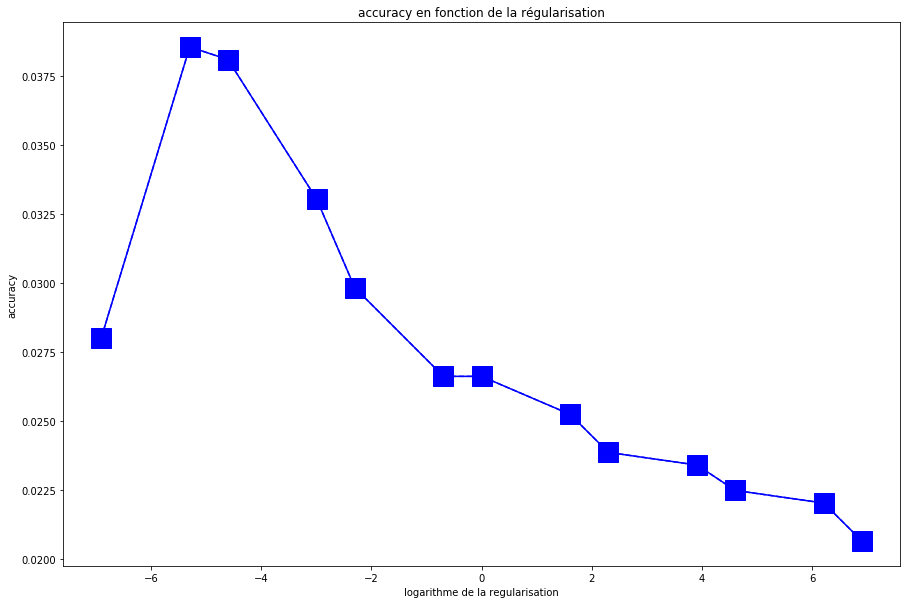

In [45]:
# tracer la courbe du score en fonction du log de la régularisation 
plt.figure(figsize=(15,10))

plt.title("accuracy en fonction de la régularisation")
plt.xlabel("logarithme de la regularisation")
plt.ylabel('accuracy')

plt.plot(np.log(reg[:]) , accuracy[:],  marker='s',markersize=20, c='blue') 
plt.plot(np.log(reg[:]) , accuracy[:], '--',markersize=5, c='blue')


plt.savefig('reg_super.jpg')


plt.show()

In [46]:
reg = 0.005

# créer un modèle de regression logistique 

clf = LogisticRegression(C=reg)

# utiliser one vs rest pour résoudre    

ovc = OneVsRestClassifier(estimator=clf).fit(hist,y_train) 

dump(ovc, 'model_full2.joblib') 

y_predict = ovc.predict_proba(hist_te)

heatmatrix = acc_heatmap(predictions=y_predict,y_test=y_test,nb_classes=nb_classes)

acc = np.trace(heatmatrix) / heatmatrix.shape[0]    
       



(120, 3)
120


In [47]:
print ('laccuracy sur le jeu final est : {} pourcents'.format(acc*100))

laccuracy sur le jeu final est : 3.7895495855231345 pourcents


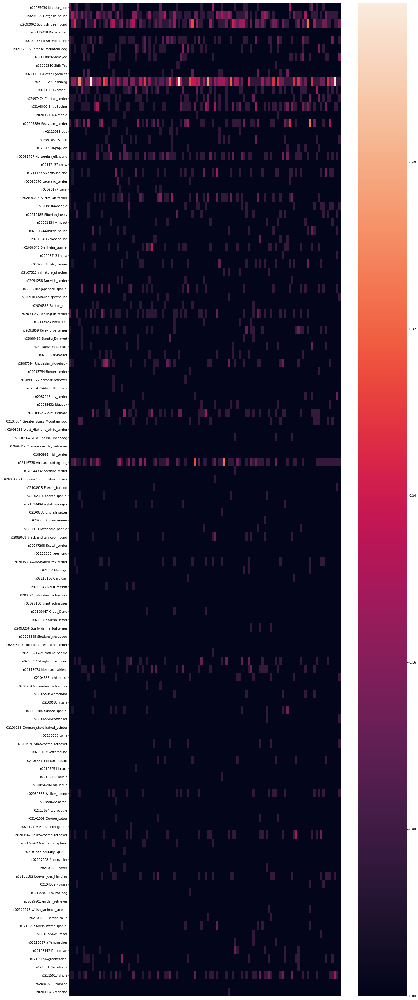

In [48]:
plt.figure(figsize=(20,60))

ax = sns.heatmap(heatmatrix,annot=False,yticklabels=liste_name)

ax.axes.get_xaxis().set_visible(False)

plt.savefig('heatmap_manual.png')

In [49]:
def performance_best(liste_name,heatmap,nb):
    """retourne la liste des nb meilleures performances (race/race) ainsi que la liste des accuracies"""
    perf_name = []
    perf_element = []    
    
    for i in range (heatmap.shape[0]):
        
        perf_element.append(heatmap[i,i])
        perf_name.append(liste_name[i])
        
    d = {'name': perf_name[:], 'acc': perf_element[:]}
    df = pd.DataFrame(data=d)
    
    df = df.sort_values(by=['acc'], ascending=[False])
    
    a = heatmap.copy()
    for i in range (heatmap.shape[0]):        
         
        # on ne tient pas compte des éléments sur la diagonale
        a[i,i] = 0
        
    liste_predict, liste_test, value = [], [], []
    for i in range (nb):        
               
        z = (np.argmax(a) + 1) / a.shape[0]
        #print (z)

        if ((np.argmax(a)+1)%(a.shape[0]) == 0):

            ordd = int(z) - 1
            abss = a.shape[0] - 1

        else : 

            ordd = int(z)
            abss = (np.argmax(a)+1)%(a.shape[0]) - 1 
            
        liste_predict.append(liste_name[ordd])        
        liste_test.append(liste_name[abss])
        
        value.append(a[ordd,abss])
            
        a[ordd,abss] = 0 
        
    d = {'predict': liste_predict[:], 'test': liste_test[:], 'fp':value[:]}
    df2 = pd.DataFrame(data=d) 
    
    df2 = df2.sort_values(by=['fp'], ascending=[False])
    
    
    return (df,df2)
        

In [50]:
df, df2 = performance_best(liste_name=liste_name[:],heatmap=heatmatrix[:,:],nb=5)[:]

No handles with labels found to put in legend.
C:\Users\tanne\Anaconda3\lib\site-packages\matplotlib\legend.py:641: UserWarning: Unrecognized location "accuracies". Falling back on "best"; valid locations are
	best
	upper right
	upper left
	lower left
	lower right
	right
	center left
	center right
	lower center
	upper center
	center

  % (loc, '\n\t'.join(self.codes)))


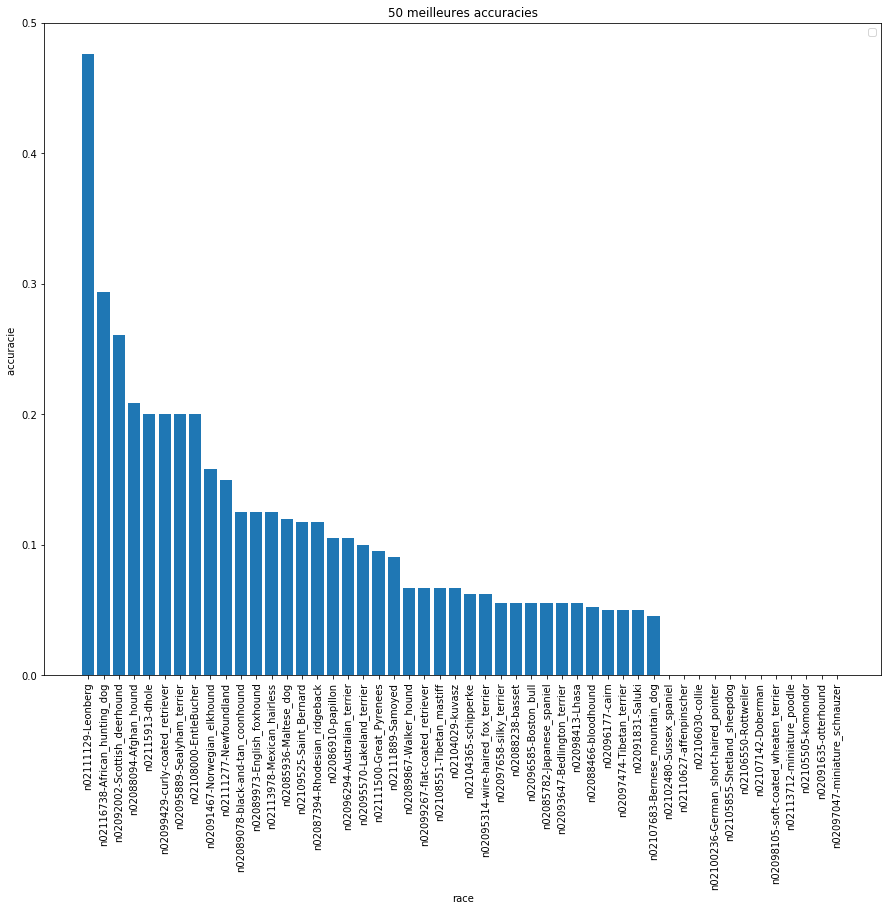

In [51]:
# afficher les performances pour les 50 races les mieux détectées

plt.figure(figsize=(15,12))
plt.title('50 meilleures accuracies')
plt.bar(df.iloc[0:50,0],df.iloc[0:50,1])
plt.legend(loc = 'accuracies')
        
plt.axis('tight')
plt.ylabel('accuracie ')
plt.xlabel('race')

plt.xticks(rotation=90)
plt.savefig('best_acc.png', dpi=400)
plt.show()  

In [53]:
# afficher les performance pour les 30 couples de races avec les plus d'erreur de prédiction (faux positifs)
df2

,predict,test,fp
0,n02111129-Leonberg,n02088632-bluetick,0.470588
1,n02111129-Leonberg,n02115913-dhole,0.466667
2,n02111129-Leonberg,n02100735-English_setter,0.375000
3,n02111129-Leonberg,n02090721-Irish_wolfhound,0.363636
4,n02092002-Scottish_deerhound,n02106382-Bouvier_des_Flandres,0.333333


# Essayer d'autres modèles (random forest / neural network)

In [84]:
# neural network model
       
accuracy = []   
        
# create the model    
        
model = Sequential()

model.add(Dense(1000, input_shape=(hist.shape[1],),activation='relu'))

model.add(Dropout(0.2))

model.add(Dense(y_train.shape[1], activation='softmax'))


model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])

print(model.summary())

model.fit(hist, y_train, validation_data=([hist_valid], y_valid), epochs=20, batch_size=10000)
        


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_29 (Dense)             (None, 1000)              1801000   
_________________________________________________________________
dropout_15 (Dropout)         (None, 1000)              0         
_________________________________________________________________
dense_30 (Dense)             (None, 120)               120120    
Total params: 1,921,120
Trainable params: 1,921,120
Non-trainable params: 0
_________________________________________________________________
None
Train on 6176 samples, validate on 2179 samples
Epoch 1/20
6176/6176 [==============================] - 3s 440us/step - loss: 4.8939 - acc: 0.0076 - val_loss: 4.8053 - val_acc: 0.0115
Epoch 2/20
6176/6176 [==============================] - 2s 261us/step - loss: 4.6930 - acc: 0.0261 - val_loss: 4.7901 - val_acc: 0.0151
Epoch 3/20
6176/6176 [==============================] - 2s 255us/step -

In [85]:
y_predict = model.predict(hist_te)

# on selectionne grace à l'accuracy

acc = 0

for i in range (y_predict.shape[0]):
    if (np.argmax(y_predict[i,:]) == np.argmax(y_test[i,:])):
        acc = acc + 1


acc = acc / y_predict.shape[0]

accuracy.append(acc)

In [86]:
print ('accuracy du réseau de neurones : {} pourcent'.format(acc*100))

accuracy du réseau de neurones : 3.8368139873725107 pourcent


In [87]:
heatmatrix = acc_heatmap(predictions=y_predict,y_test=y_test,nb_classes=nb_classes)

(120, 3)
120


No handles with labels found to put in legend.
C:\Users\tanne\Anaconda3\lib\site-packages\matplotlib\legend.py:641: UserWarning: Unrecognized location "accuracies". Falling back on "best"; valid locations are
	best
	upper right
	upper left
	lower left
	lower right
	right
	center left
	center right
	lower center
	upper center
	center

  % (loc, '\n\t'.join(self.codes)))


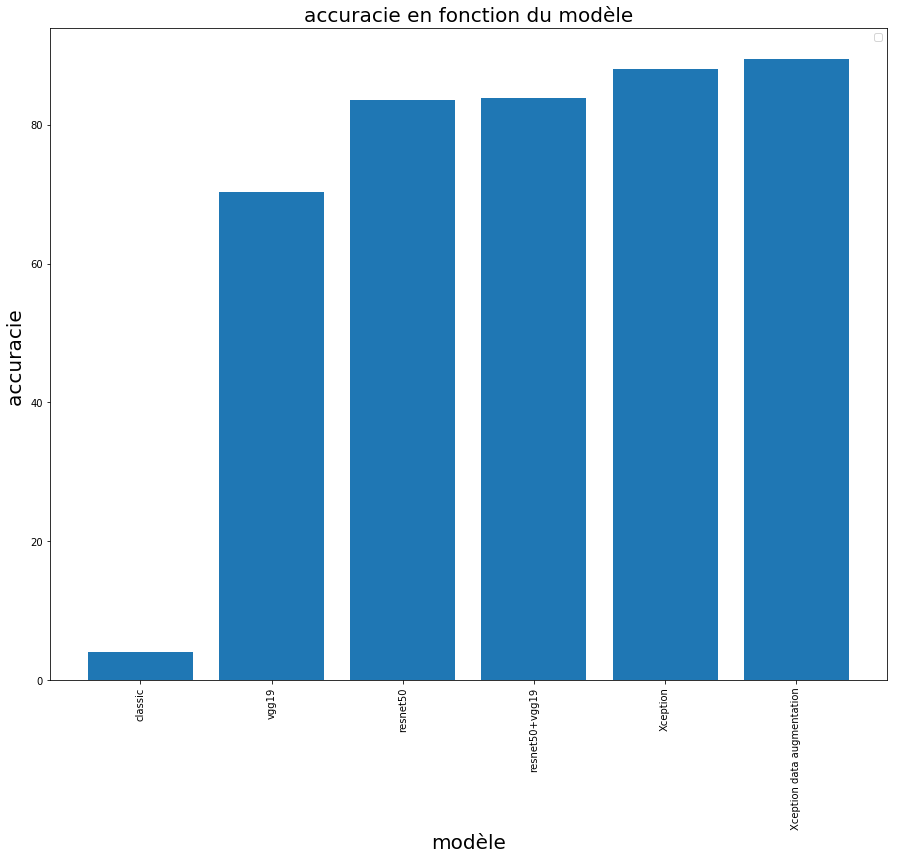

In [225]:
a = [4,70.26,83.57,83.8,88.1,89.5]
name = ['classic','vgg19','resnet50','resnet50+vgg19','Xception','Xception data augmentation']

# afficher les performances pour les 50 races les mieux détectées

plt.figure(figsize=(15,12))
plt.title('accuracie en fonction du modèle',fontsize=20)
plt.bar(name[:],a[:])
plt.legend(loc = 'accuracies')
        
plt.axis('tight')
plt.ylabel('accuracie ',fontsize=20)
plt.xlabel('modèle',fontsize=20)

plt.xticks(rotation=90)
plt.savefig('best_acc.png', dpi=400)
plt.show()  

In [88]:
df, df2 = performance_best(liste_name=liste_name[:],heatmap=heatmatrix[:,:],nb=5)[:]

No handles with labels found to put in legend.
C:\Users\tanne\Anaconda3\lib\site-packages\matplotlib\legend.py:641: UserWarning: Unrecognized location "accuracies". Falling back on "best"; valid locations are
	best
	upper right
	upper left
	lower left
	lower right
	right
	center left
	center right
	lower center
	upper center
	center

  % (loc, '\n\t'.join(self.codes)))


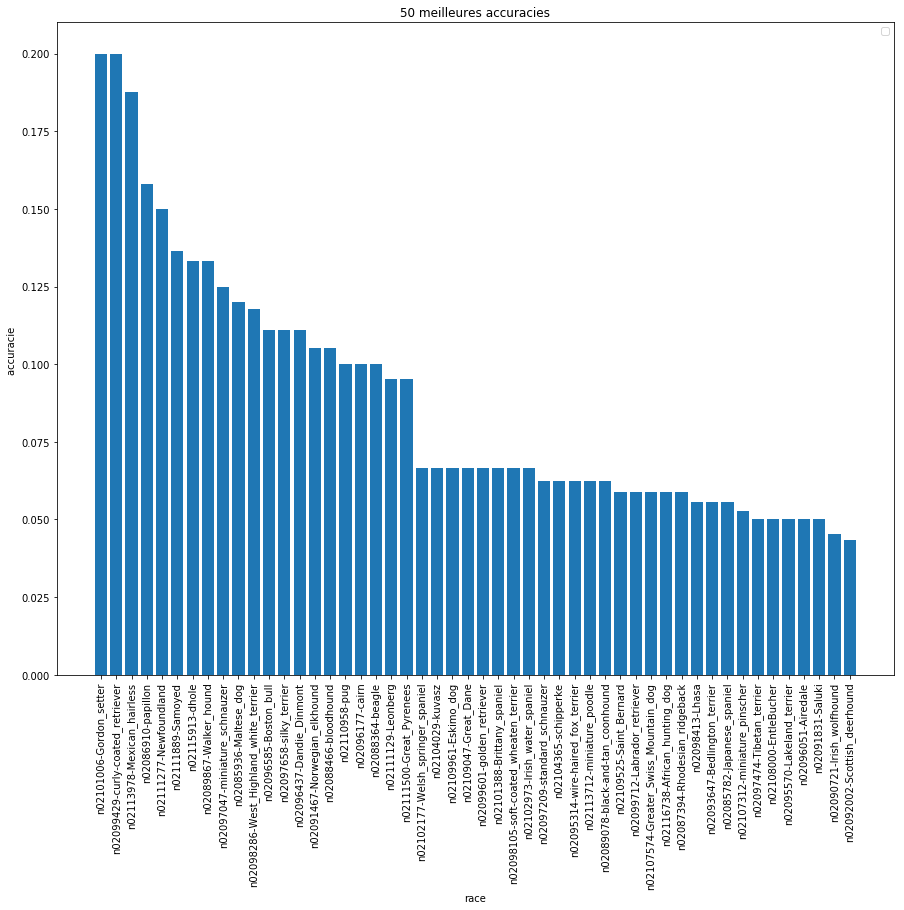

In [89]:
# afficher les performances pour les 50 races les mieux détectées

plt.figure(figsize=(15,12))
plt.title('50 meilleures accuracies')
plt.bar(df.iloc[0:50,0],df.iloc[0:50,1])
plt.legend(loc = 'accuracies')
        
plt.axis('tight')
plt.ylabel('accuracie ')
plt.xlabel('race')

plt.xticks(rotation=90)
plt.savefig('best_acc.png', dpi=400)
plt.show()  

On voit donc que, même si le modèle de classification logistique et le réseau de neurones ont des performances similaires. La segmentation ne s'effectue pas de la même manière.
La regression logistique segmente linéairement et maximise les performances d'un petit nombre de classes. Le réseau de neuronnes obtient des performances moins bonnes sur certaines classes mais en considère beaucoup plus.


